# GeoDN Course 2: Fundamentals of Geospatial Data and Modeling - Part 1 Geospatial Data Discovery for Climate Risk #
> Copyright (c) 2024 International Business Machines Corporation

> This software is released under the MIT License.
> https://opensource.org/licenses/MIT

# Session 3 - Impact Functions with OpenStreetMaps and Flood Outlines

In this notebook, we will attempt to conduct building-level impact modeling.

Please note that the first part is the same as session 2, but explained again in case someone wants to run this Notebook in a standalone version. 

Steps:

1. Pick your Region of Interest (ROI)  
2. Get all ROI buildings' information using OSM  
3. Classify the buildings into the categories from the paper (**assets**)   
4. Load water depth information from flood event   
5. Convert the simulation data into a `GeoDataFrame` with (`intensity`, `lat`, `lon`) and filter it to the ROI   
6. Average-Aggregate the intensity points over the buildings of interest   
7. Calculate the **damage** using the **intensity** and **impact function** implementation   
8. Visualise Impact   

### Prepare 

In [1]:
from pathlib import Path
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import osmnx as ox
import contextily as cx
from impact_funs.flood.us_omar_2020 import USOmar2020
import seaborn as sns
import folium

<font color='white'>********************************************************************************************************************************************************************</font>

# 1) Pick your Region of Interest (ROI)

In our case this is still the Hull shapefile. This is a shapefile that contains the outline of Hull City. We use this so that we have the coordinates and outlines as a geospatial file. We can then use that later to pull data for that specific outline of Hull. 



In [2]:
#Load file
shpFilePath='shapefiles/cutline.shp'
hull = gpd.read_file(shpFilePath)

#Specify map object
map = folium.Map(location=[53.76,-0.35], tiles="CartoDB Positron", zoom_start=11)

# Add the GeoDataFrame to the map.
hull.explore(m=map,color='blue')

<font color='white'>********************************************************************************************************************************************************************</font>

# 2) Get all ROI buildings' information using OpenStreetMaps (OSM)

We use OpenStreetmaps to get all buildings outlines for our area of interest. OpenStreetMaps has a tag system where everything on a map is classified into a building, road, land etc. Each tag has then a specific key which gives more details. For example a shape on OSM is tagged as a building and the specific type (key) is "apartment". 

We extracted all the buildings from OpenStreetMaps, see here all available types: https://wiki.openstreetmap.org/wiki/Map_features
    


In [3]:
# Set all possible building types
building_types = [
    "apartments", "barracks", "bungalow", "cabin", "detached",
    "dormitory", "farm", "ger", "hotel", "house", "houseboat",
    "residential", "semidetached_house", "static_caravan", "commercial", "industrial",
    "kiosk", "office", "retail", "supermarket", "warehouse", "cathedral", "chapel",
    "church", "monastery", "mosque", "presbytery", "religious", "shrine", "synagogue",
    "temple", "bakehouse", "civic", "college", "fire_station", "government", "hospital",
    "kindergarten", "public", "school", "toilets", "train_station", "transportation",
    "university", "barn", "conservatory", "cowshed", "farm_auxiliary", "greenhouse",
    "slurry_tank", "stable", "sty", "grandstand", "pavilion", "riding_hall", "sports_hall",
    "stadium", "hangar", "hut", "shed", "carport", "garage", "garages", "parking", "digester",
    "service", "transformer_tower", "water_tower", "beach_hut", "bunker", "bridge", "castle",
    "construction", "container", "gatehouse", "military", "roof", "ruins", "tent", "tree_house"
]

Then we set up the function to retrieve the buildings from OSM. 

In [4]:
# We create a function to call all buildings for a place, in this case city
def get_buildings(place, building_type):
    
    # We are interested in buildings
    tags = {"building": building_type}
    
    # Acquire buildings' Geodataframe
    gdf = ox.features_from_place(place, tags) 
    
    # Add the tag to it
    gdf["building_type"] = building_type
    
    return gdf

Now run this function for a place of choice and set a path where it is saved as a shapefile, so we don't have to re-run this again. 


In [5]:

# Set the data path
data_path = Path("buildings.shp")

place = "Hull"
gdfs = list()
for building_type in building_types:
    print(f"Acquiring {building_type} within {place}....")
    try:
        gdfs.append(get_buildings(place, building_type))
    except:
        pass

    # Concatenate all geodataframes
gdf = pd.concat(gdfs).reset_index()
gdf = gdf[["building", "geometry"]]
gdf = gdf.rename(columns={"building": "btype"})
gdf = gdf[gdf["geometry"].type != "Point"]
# Save
gdf.to_file(data_path)

Acquiring apartments within Hull....
Acquiring barracks within Hull....
Acquiring bungalow within Hull....
Acquiring cabin within Hull....
Acquiring detached within Hull....
Acquiring dormitory within Hull....
Acquiring farm within Hull....
Acquiring ger within Hull....
Acquiring hotel within Hull....
Acquiring house within Hull....
Acquiring houseboat within Hull....
Acquiring residential within Hull....
Acquiring semidetached_house within Hull....
Acquiring static_caravan within Hull....
Acquiring commercial within Hull....
Acquiring industrial within Hull....
Acquiring kiosk within Hull....
Acquiring office within Hull....
Acquiring retail within Hull....
Acquiring supermarket within Hull....
Acquiring warehouse within Hull....
Acquiring cathedral within Hull....
Acquiring chapel within Hull....
Acquiring church within Hull....
Acquiring monastery within Hull....
Acquiring mosque within Hull....
Acquiring presbytery within Hull....
Acquiring religious within Hull....
Acquiring shrin

What is returned is a geodataframe, containing the building type (`btype`) and Polygon information about this building. The Polygon information let's plot the buildings on a map and we use those Polygon outlines to match/intersect with the flood outlines later on. 

In [6]:
gdf

,btype,geometry
0,apartments,"POLYGON ((-0.33063 53.74271, -0.33030 53.74265..."
1,apartments,"POLYGON ((-0.32890 53.74491, -0.32874 53.74490..."
2,apartments,"POLYGON ((-0.32950 53.74437, -0.32901 53.74423..."
3,apartments,"POLYGON ((-0.33007 53.74490, -0.33000 53.74492..."
4,apartments,"POLYGON ((-0.33535 53.73787, -0.33528 53.73775..."
...,...,...
64911,roof,"POLYGON ((-0.28569 53.74898, -0.28570 53.74892..."
64912,roof,"POLYGON ((-0.33874 53.74532, -0.33877 53.74532..."
64913,roof,"POLYGON ((-0.34459 53.74551, -0.34420 53.74550..."
64914,roof,"POLYGON ((-0.34434 53.74507, -0.34434 53.74505..."


Next we want to do a sanity check and see if we actually got the right place and all the buildings, so we plot it on a map. We want to make sure that the buildings we pulled from OpenStreetMap actually are in the right place, in this case Hull, and not somewhere else in the world in case we used the wrong coordinates or so.

In [7]:
#Specify map object
map = folium.Map(location=[53.76,-0.35], tiles="CartoDB Positron", zoom_start=11)

# Add the GeoDataFrame to the map.
gdf.explore(m=map,color='red')

Now we are certain that we have the right place we see how many buildings of all types we have and calculate the frequency of all the buildings in the geodataframe we pulled. 

In [8]:
#Plot frequency of buildings on the Glasgow City Region
import matplotlib.pyplot as plt
building_freq = pd.DataFrame(gdf['btype'].value_counts()).reset_index()
building_freq.columns=['btype','count']
building_freq

,btype,count
0,house,63453
1,apartments,368
2,residential,345
3,school,162
4,garage,121
5,retail,81
6,church,58
7,commercial,55
8,construction,44
9,garages,39


<font color='white'>********************************************************************************************************************************************************************</font>

# 3) Classify the buildings into the categories from the paper (**assets**).

Based on the paper `Nofal, Omar M., and John W. van de Lindt. "Minimal building flood fragility and loss function portfolio for
resilience analysis at the community level." Water 12.8 (2020): 2277. `, buildings can be classified in different assets as floods obviously have a different affect on a bungalow vs an apartment block. The categorisation is done by hand but the function is provided below. For that we take the description from OpenStreetMaps and then we are recategorising the many open street map building types into 15 types for which we have impact functions. See the type description below:

![Building Categorisation](building_fragility_categorisation.png)

### Type descriptions from Open Street Maps are mapped on the buildings above:

In [9]:
type_descriptions = {
    "house": "A dwelling unit inhabited by a single household (a family or small group sharing facilities such as a kitchen). Houses forming half of a semi-detached pair, or one of a row of terraced houses, should share at least two nodes with joined neighbours, thereby defining the party wall between the properties.",
    "residential": "A general tag for a building used primarily for residential purposes. Where additional detail is available consider using 'apartments', 'terrace', 'house', 'detached' or 'semidetached_house'.",
    "retail": "A building primarily used for selling goods that are sold to the public; use shop=* to identify the sort of goods sold or an appropriate amenity=* (pub, cafe, restaurant, etc.). Consider use landuse=retail for the surrounding area.",
    "school": "A building errected as school. Buildings for specific uses (sports halls etc.) should be tagged for their purpose. If there is currently a school, use amenity=school on the perimeter of the school grounds.",
    "commercial": "A building for non-specific commercial activities, not necessarily an office building. Consider tagging the surrounding area using landuse=commercial if there is such use. Use 'retail' if the building consists primarily of shops.",
    "roof": "A structure that consists of a roof with open sides, such as a rain shelter, and also gas stations",
    "university": "A university building. Use amenity=university for the university as an institution.",
    "office": "An office building. Use office=* where applicable for the business(es) that use the building. Consider tagging the surrounding area using landuse=commercial if it applies. Prefer 'retail' if the building consists primarily of shops.",
    "industrial": "A building for industrial purposes. Use warehouse if the purpose is known to be primarily for storage/distribution. Consider using landuse=industrial for the surrounding area and appropriate tags like man_made=works to describe the industrial activity.",
    "church": "A building that was built as a church. Used in conjunction with amenity=place_of_worship, religion=* , denomination=* and landuse=religious for the church grounds where it is in current use.",
    "hospital": "A building errected for a hospital. Use amenity=hospital for the hospital grounds.",
    "detached": "A detached house, a free-standing residential building usually housing a single family.",
    "warehouse": "A building primarily intended for the storage or goods or as part of a distribution system.",
    "college": "A college building. Use amenity=college on the whole college area to represent the college as an institution.",
    "synagogue": "A building that was built as a synagogue. Used in conjunction with amenity=place_of_worship, religion=*, denomination=* and landuse=religious for the grounds where it is in current use.",
    "kiosk": "A small one-room retail building.",
    "dormitory": "A shared building intended for college/university students (not a share room for multiple occupants as implied by the term in British English). Alternatively, use building=residential plus residential=university and loose the information that it is for students."
}

Now we put all OpenStreetMap building types into the categories 1-15 based on the above. Obviously some buildings, like a semi-detached house and detached house would fall into the same category. `archtype` refers to the category 1-15 here. Note, we're not using all the 15 categories here. 

In [10]:
type2btypes = {
    "F1": ["house", "detached","semidetached_house"],
    "F2": [],
    "F3": ["residential"],
    "F4": [],
    "F5": ["retail", "roof", "kiosk"],
    "F6": [],  # Multi-unit retail building (strip mall).
    "F7": ["commercial","farm","shed"],
    "F8": [],  # Super retail center.
    "F9": ["industrial","garages"],
    "F10": ["school", "college"],
    "F11": ["university", "dormitory"],
    "F12": ["hospital"],
    "F13": ["church", "synagogue"],
    "F14": ["office","apartments"],
    "F15": ["warehouse","garage"]
}


#Let's make each building type point to its archtype:
btype2type = dict()
for archtype, btypes in type2btypes.items():
    while btypes:
        btype2type[btypes.pop()] = archtype


gdf["archtype"] = gdf["btype"].replace(btype2type)
gdf = gdf[gdf["archtype"].isin([f"F{i}" for i in range(16)])]
gdf

,btype,geometry,archtype
0,apartments,"POLYGON ((-0.33063 53.74271, -0.33030 53.74265...",F14
1,apartments,"POLYGON ((-0.32890 53.74491, -0.32874 53.74490...",F14
2,apartments,"POLYGON ((-0.32950 53.74437, -0.32901 53.74423...",F14
3,apartments,"POLYGON ((-0.33007 53.74490, -0.33000 53.74492...",F14
4,apartments,"POLYGON ((-0.33535 53.73787, -0.33528 53.73775...",F14
...,...,...,...
64911,roof,"POLYGON ((-0.28569 53.74898, -0.28570 53.74892...",F5
64912,roof,"POLYGON ((-0.33874 53.74532, -0.33877 53.74532...",F5
64913,roof,"POLYGON ((-0.34459 53.74551, -0.34420 53.74550...",F5
64914,roof,"POLYGON ((-0.34434 53.74507, -0.34434 53.74505...",F5


Now we have mapped the OpenStreetMap buildings into the categories, we will plot again. We will use a standard `matplotlib` plot now so we can label the buildings according to their archtype. We build a function for that to do it quickly.

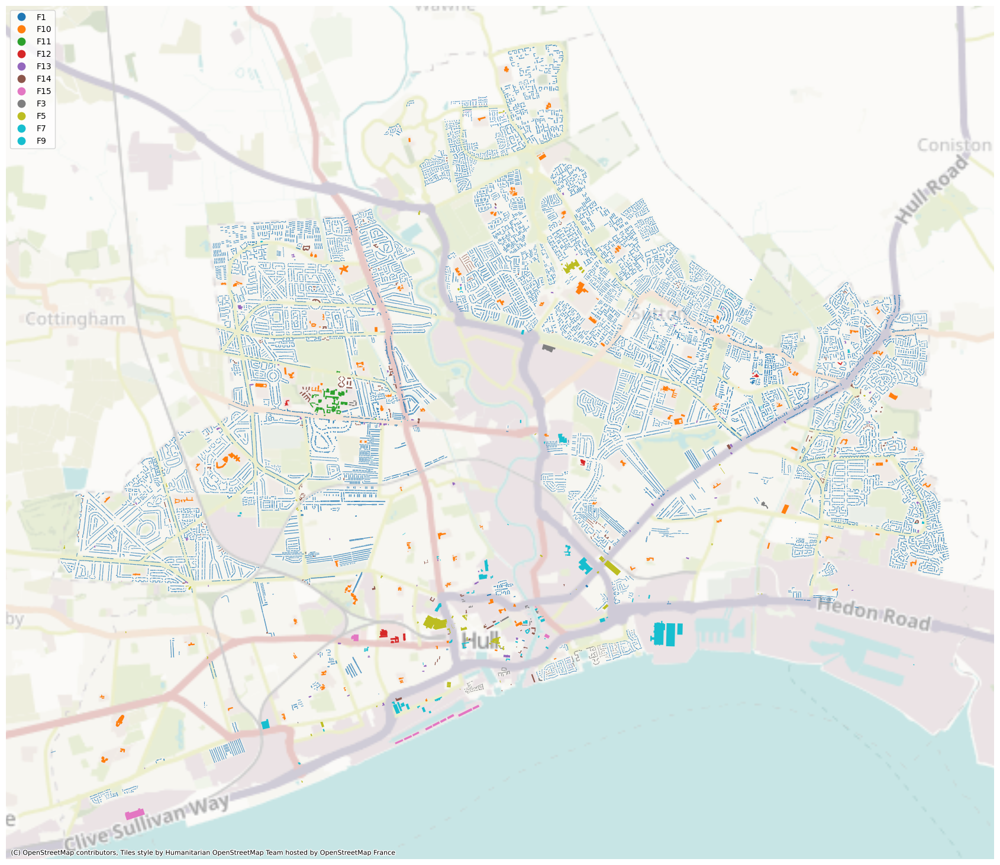

In [11]:
# Re-project so we can add the basemap

def plot_buildings(gdf, building_type_column="btype", legend_loc="upper left", figsize=(17, 17), basemap=True):
    """Plots the geodataframes buildings."""
    
    # Copy the dataframe
    df = gdf.copy()
    
    # Plot and save building image
    fig, ax = plt.subplots(figsize=figsize)

    # Plot
    ax = df.plot(ax=ax, column=building_type_column, 
                 categorical=True, legend=True, 
                 cmap="tab10", legend_kwds={"loc": legend_loc})

    # Add a basemap
    if basemap:
        cx.add_basemap(ax, alpha=0.5)
    
    # Show the plot
    plt.axis("off")
    fig.tight_layout()
    plt.show()

df = gdf.to_crs(epsg=3857)
plot_buildings(df, building_type_column="archtype", basemap=True)



<font color='white'>********************************************************************************************************************************************************************</font>

# 4) Load water depth information from Environment Agency (EA) Flood Model

Now we re-load the flood data with the flood depth so we can overlay that with the building data and calculate the fragility in section 7). 
EA surface water flood risk maps - these are risk maps created by the environment agency for different storm scenarios. In this case, we use the scenario of an extreme storm, occurring once in 1000 years (called 1in1000). 

This step below takes a few minutes as the shapefile is quite large. 

## Not needed, already done but keep for reference if needed again

##### Use tiles and put them together in one shapefile for the area of hull, then clip again to Hull
```
tileone = gpd.read_file('RoFSW-TA02/RoFSW_TA02_Extent_1in1000.shp')
tiletwo = gpd.read_file('RoFSW-TA13/RoFSW_TA13_Extent_1in1000.shp')
tilethree = gpd.read_file('RoFSW-TA12/RoFSW_TA12_Extent_1in1000.shp')
tilefour = gpd.read_file('RoFSW-TA03/RoFSW_TA03_Extent_1in1000.shp')
```

##### Merge/Combine multiple shapefiles into one
```
all_hull = gpd.pd.concat([tileone, tiletwo,tilethree,tilefour])
#Clip to Hull outline
all_hull = all_hull.to_crs(4326)
#Clip flood extents to Hull only 
all_hull= gpd.clip(all_hull, hull)
all_hull.plot()
#Export merged geodataframe into shapefile
all_hull.to_file("shapefiles/hull_1in1000_storm.shp")
```

Loading the shapefile of flood outlines from the EA 1 in 1000 Storm model can take a few minutes

<Axes: >

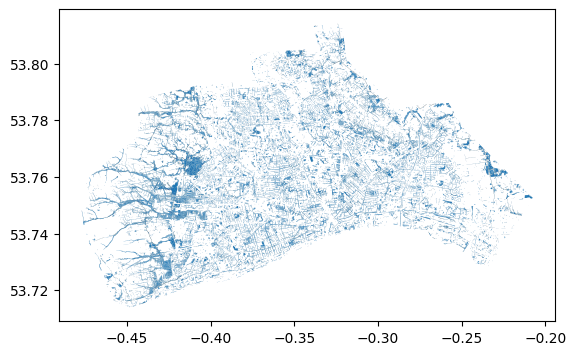

In [19]:
#Load shapefile
shpFilePath_flood='shapefiles/hull_1in1000_storm.shp'
flood = gpd.read_file(shpFilePath_flood)
flood.plot()


We can have a quick look at the flood dataframe and see that there are the polygons and they have flood depth in them - see first column in the dataframe. 

In [22]:
flood

,depth,pub_date,tile_id,shape_leng,shape_area,st_area_wk,st_perimet,geometry
0,> 1.20,2013-03-01,TA00,8.0,4.0,4.0,8.0,"POLYGON ((-0.27151 53.78544, -0.27151 53.78546..."
1,0.60 - 0.90,2013-03-01,TA00,8.0,4.0,4.0,8.0,"POLYGON ((-0.27154 53.78544, -0.27154 53.78546..."
2,0.30 - 0.60,2013-03-01,TA00,8.0,4.0,4.0,8.0,"POLYGON ((-0.27142 53.78548, -0.27138 53.78548..."
3,0.90 - 1.20,2013-03-01,TA00,8.0,4.0,4.0,8.0,"POLYGON ((-0.27145 53.78546, -0.27145 53.78548..."
4,> 1.20,2013-03-01,TA00,8.0,4.0,4.0,8.0,"POLYGON ((-0.27148 53.78546, -0.27148 53.78548..."
...,...,...,...,...,...,...,...,...
430898,0.15 - 0.30,2013-03-01,TA00,924.0,1956.0,1956.0,924.0,"POLYGON ((-0.38985 53.76225, -0.38985 53.76223..."
430899,0.00 - 0.15,2013-03-01,TA00,8.0,4.0,4.0,8.0,"POLYGON ((-0.38768 53.76195, -0.38768 53.76193..."
430900,0.00 - 0.15,2013-03-01,TA00,8.0,4.0,4.0,8.0,"POLYGON ((-0.38774 53.76195, -0.38774 53.76193..."
430901,0.00 - 0.15,2013-03-01,TA00,8.0,4.0,4.0,8.0,"POLYGON ((-0.38941 53.76193, -0.38941 53.76195..."


<font color='white'>********************************************************************************************************************************************************************</font>

# 5) Convert the flood data into a `GeoDataFrame` with (`intensity`, `lat`, `lon`) and filter for our ROI

We need to tidy up the dataframe and re-categorise the flood depth from a range into an actual float value as the impact function takes in the actual flood depth. We will use the maximum flood depth and convert that into meters. 

First we look at what depth values are in the original dataframe from the EA 1 in 1000 Storm model are: 


In [23]:
# Check what depth values we have to create a remap dictionary
check = pd.DataFrame(flood['depth'].value_counts()).reset_index()
check.columns=['depth','count']
check

,depth,count
0,0.15 - 0.30,177800
1,0.00 - 0.15,144173
2,0.30 - 0.60,87451
3,0.60 - 0.90,14577
4,0.90 - 1.20,5461
5,> 1.20,1441


Now we will replace depth category values with float numbers, so for example `depth 0.15-0.30` will be replaced by `0.30`. We take the maximum flood value here, so to be sure we account for the worst case scenario. 

In [24]:
# Define Dict with the key-value pair to remap.
conversion_dict = {"0.00 - 0.15":0.15, 
                        "0.15 - 0.30":0.3,
                        "0.30 - 0.60":0.6,
                        "0.60 - 0.90":0.9,
                        "0.90 - 1.20":1.2,
                        "> 1.20":1.3}
flood=flood.replace({"depth": conversion_dict})
flood

,depth,pub_date,tile_id,shape_leng,shape_area,st_area_wk,st_perimet,geometry
0,1.30,2013-03-01,TA00,8.0,4.0,4.0,8.0,"POLYGON ((-0.27151 53.78544, -0.27151 53.78546..."
1,0.90,2013-03-01,TA00,8.0,4.0,4.0,8.0,"POLYGON ((-0.27154 53.78544, -0.27154 53.78546..."
2,0.60,2013-03-01,TA00,8.0,4.0,4.0,8.0,"POLYGON ((-0.27142 53.78548, -0.27138 53.78548..."
3,1.20,2013-03-01,TA00,8.0,4.0,4.0,8.0,"POLYGON ((-0.27145 53.78546, -0.27145 53.78548..."
4,1.30,2013-03-01,TA00,8.0,4.0,4.0,8.0,"POLYGON ((-0.27148 53.78546, -0.27148 53.78548..."
...,...,...,...,...,...,...,...,...
430898,0.30,2013-03-01,TA00,924.0,1956.0,1956.0,924.0,"POLYGON ((-0.38985 53.76225, -0.38985 53.76223..."
430899,0.15,2013-03-01,TA00,8.0,4.0,4.0,8.0,"POLYGON ((-0.38768 53.76195, -0.38768 53.76193..."
430900,0.15,2013-03-01,TA00,8.0,4.0,4.0,8.0,"POLYGON ((-0.38774 53.76195, -0.38774 53.76193..."
430901,0.15,2013-03-01,TA00,8.0,4.0,4.0,8.0,"POLYGON ((-0.38941 53.76193, -0.38941 53.76195..."


Let's see the frequencies of the depths to make sure we're not just looking at one category of flood depths. On the x-axis we have the flood depth in meters an on the y axis the frequency. 


<Axes: >

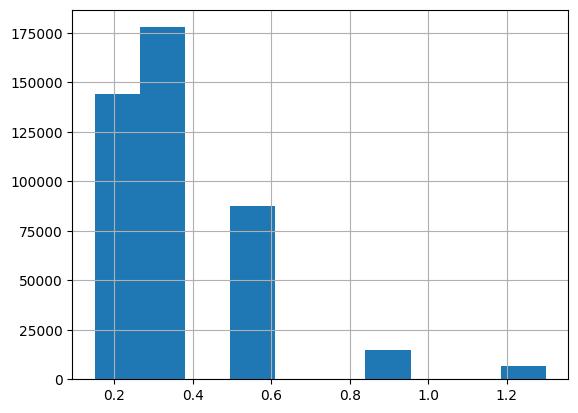

In [25]:
flood.depth.hist()

<font color='white'>********************************************************************************************************************************************************************</font>

# 6. Aggregate the intensity points over the buildings of interest.

Here we will now calculate the intersect between buildings and the flood outlines to see how much each building is flooded. 


In [26]:
# Get the data of interest
intensities = flood[['depth','geometry']].copy()
buildings = gdf.copy()
intensities.shape, buildings.shape

((430903, 2), (64831, 3))

Let's look at the dataframes again and what columns we have. 

In [27]:
intensities

,depth,geometry
0,1.30,"POLYGON ((-0.27151 53.78544, -0.27151 53.78546..."
1,0.90,"POLYGON ((-0.27154 53.78544, -0.27154 53.78546..."
2,0.60,"POLYGON ((-0.27142 53.78548, -0.27138 53.78548..."
3,1.20,"POLYGON ((-0.27145 53.78546, -0.27145 53.78548..."
4,1.30,"POLYGON ((-0.27148 53.78546, -0.27148 53.78548..."
...,...,...
430898,0.30,"POLYGON ((-0.38985 53.76225, -0.38985 53.76223..."
430899,0.15,"POLYGON ((-0.38768 53.76195, -0.38768 53.76193..."
430900,0.15,"POLYGON ((-0.38774 53.76195, -0.38774 53.76193..."
430901,0.15,"POLYGON ((-0.38941 53.76193, -0.38941 53.76195..."


In [28]:
buildings

,btype,geometry,archtype
0,apartments,"POLYGON ((-0.33063 53.74271, -0.33030 53.74265...",F14
1,apartments,"POLYGON ((-0.32890 53.74491, -0.32874 53.74490...",F14
2,apartments,"POLYGON ((-0.32950 53.74437, -0.32901 53.74423...",F14
3,apartments,"POLYGON ((-0.33007 53.74490, -0.33000 53.74492...",F14
4,apartments,"POLYGON ((-0.33535 53.73787, -0.33528 53.73775...",F14
...,...,...,...
64911,roof,"POLYGON ((-0.28569 53.74898, -0.28570 53.74892...",F5
64912,roof,"POLYGON ((-0.33874 53.74532, -0.33877 53.74532...",F5
64913,roof,"POLYGON ((-0.34459 53.74551, -0.34420 53.74550...",F5
64914,roof,"POLYGON ((-0.34434 53.74507, -0.34434 53.74505...",F5


Here comes the important step where we merge the building location with the flood extents and their depth

In [29]:
# Merge it
building_intensity = gpd.sjoin(buildings, intensities, how="left").drop("index_right", axis=1)
#Tidy
building_intensity = building_intensity[["btype","archtype", "depth", "geometry"]]
# Remove null values
building_intensity = building_intensity.dropna()
building_intensity.shape

(17023, 4)

In [30]:
building_intensity

,btype,archtype,depth,geometry
51,apartments,F14,0.30,"POLYGON ((-0.36970 53.77827, -0.36970 53.77819..."
51,apartments,F14,0.30,"POLYGON ((-0.36970 53.77827, -0.36970 53.77819..."
51,apartments,F14,0.60,"POLYGON ((-0.36970 53.77827, -0.36970 53.77819..."
53,apartments,F14,0.30,"POLYGON ((-0.36907 53.77842, -0.36906 53.77831..."
53,apartments,F14,0.30,"POLYGON ((-0.36907 53.77842, -0.36906 53.77831..."
...,...,...,...,...
64914,roof,F5,0.60,"POLYGON ((-0.34434 53.74507, -0.34434 53.74505..."
64915,roof,F5,0.30,"POLYGON ((-0.32217 53.78559, -0.32210 53.78554..."
64915,roof,F5,0.15,"POLYGON ((-0.32217 53.78559, -0.32210 53.78554..."
64915,roof,F5,0.15,"POLYGON ((-0.32217 53.78559, -0.32210 53.78554..."


Let's do a quick plot to look at the distribution

In [31]:
building_intensity

,btype,archtype,depth,geometry
51,apartments,F14,0.30,"POLYGON ((-0.36970 53.77827, -0.36970 53.77819..."
51,apartments,F14,0.30,"POLYGON ((-0.36970 53.77827, -0.36970 53.77819..."
51,apartments,F14,0.60,"POLYGON ((-0.36970 53.77827, -0.36970 53.77819..."
53,apartments,F14,0.30,"POLYGON ((-0.36907 53.77842, -0.36906 53.77831..."
53,apartments,F14,0.30,"POLYGON ((-0.36907 53.77842, -0.36906 53.77831..."
...,...,...,...,...
64914,roof,F5,0.60,"POLYGON ((-0.34434 53.74507, -0.34434 53.74505..."
64915,roof,F5,0.30,"POLYGON ((-0.32217 53.78559, -0.32210 53.78554..."
64915,roof,F5,0.15,"POLYGON ((-0.32217 53.78559, -0.32210 53.78554..."
64915,roof,F5,0.15,"POLYGON ((-0.32217 53.78559, -0.32210 53.78554..."


/Users/katharina/miniconda3/envs/explain/lib/python3.10/site-packages/matplotlib/scale.py:255: RuntimeWarning: overflow encountered in power
  return np.power(self.base, values)
/Users/katharina/miniconda3/envs/explain/lib/python3.10/site-packages/matplotlib/scale.py:255: RuntimeWarning: overflow encountered in power
  return np.power(self.base, values)


AttributeError: Rectangle.set() got an unexpected keyword argument 'log'

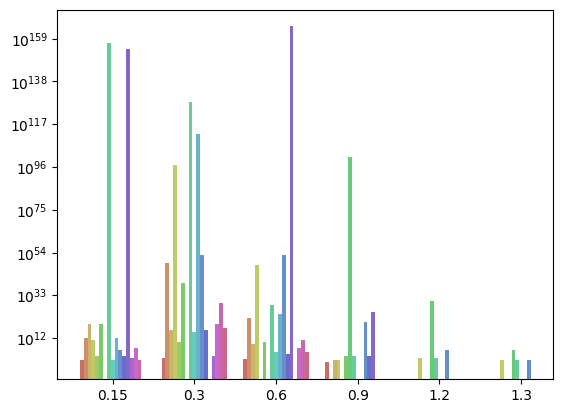

In [34]:
#Do a frequency count on flood depth and building type
df = building_intensity.copy()
df = df.groupby(['btype','depth']).count().reset_index()
del df['archtype']
# Rename columns
df.columns=['btype','depth','frequency']

#plot
ax = sns.barplot(data=df, x="depth", y="frequency", hue='btype',palette = "hls")
ax.set(xlabel='flood depth (m)', ylabel='frequency',title='assets affected by floods')
ax.legend(title='OSM Category', bbox_to_anchor=(1, 1), loc='upper left')
ax.grid(axis='x')


<font color='white'>********************************************************************************************************************************************************************</font>

# 7. Calculate the **damage** using the **intensity** and **impact function** implementation. 


From this paper https://www.mdpi.com/2073-4441/12/8/2277 this is a method that allows the development of building fragility and building loss functions is articulated and applied to develop an archetype portfolio that can be used to model buildings in a typical community. The portfolio presented herein consists of 15 building archetypes that can serve to populate a community-level model to predict damage and resulting functionality from a scenario flood event. The prediction of damage and functionality of buildings within a community is the first step in developing risk-informed mitigation decisions to improve community resilience.

This functions describes flood damage to buildings in terms of five damage states (DSs) ranging from insignificant damage (DS0) up to complete damage (DS4). 
```
damage_state: goes from DS0 to DS4.
                - DS0: Insignificant damage to components below first-floor elevation. Water enters crawlspace/basement
                    and touches foundation (crawlspace or slab on grade). Damage to components within the
                    crawlspace/basement including base insulation and stored inventory. Minor damage to garage interiors
                    including drywall, cabinets, electrical outlets, wall insulation (Garage is below the first-flood
                    elevation (FFE)). No sewer backup into the living area.
                - DS1: Water touches floor joists up to minor water entering the building. Damage to carpets, pads,
                    baseboards, flooring. Damage to the external AC unit (if the AC unit is not elevated) and the
                    attached ductworks (if ductworks are in the crawlspace). Complete damage to the garage interior
                    (if the garage is below FFE). No drywall damages with the potential of some mold on the subfloor
                    above the crawlspace. Could have a minor sewer backup and/or minor mold issue.
                - DS2: Partial damage to drywalls along with damage to electrical components (base-outlets), water
                    heater, and furnace. Complete damage to major equipment, appliances, and furniture on the first
                    floor. Damage to the lower bathroom and kitchen cabinets. Doors and windows may need replacement.
                    Could have a major sewer backup and major mold issues.
                - DS3: Damage to the non-structural components and interiors within the whole building including
                    (but not limited to) drywall damage to upper stories for multi-story buildings
                    (e.g., attic, second story, etc.). Electrical switches and mid-outlets are destroyed.
                    Damage to bathroom/kitchen upper cabinets, lighting fixtures on walls are destroyed with potential
                    damage to ceiling lighting fixtures. Studs reusable; some may be damaged. Major sewer backup will
                    happen along with major mold issues. Equipment, appliances, and furniture on the upper
                    floors are also damaged (e.g., attic, second floor, etc.).
                - DS4: Significant structural damage present (e.g., studs, trusses, joists, etc.).
                    Non-structural components and interiors are destroyed including all drywall, appliances, cabinets,
                    furniture, etc. Damage to rooftop units/components including roof insulation, sheathing,
                    and electro-mechanical systems (rooftop AC units, electrical systems, cable railing,
                    sound system, etc.). Foundation could be floated off. The building must be demolished
                    or potentially replaced.
```

In [35]:
building_intensity = building_intensity.dropna()
building_intensity

,btype,archtype,depth,geometry
51,apartments,F14,0.30,"POLYGON ((-0.36970 53.77827, -0.36970 53.77819..."
51,apartments,F14,0.30,"POLYGON ((-0.36970 53.77827, -0.36970 53.77819..."
51,apartments,F14,0.60,"POLYGON ((-0.36970 53.77827, -0.36970 53.77819..."
53,apartments,F14,0.30,"POLYGON ((-0.36907 53.77842, -0.36906 53.77831..."
53,apartments,F14,0.30,"POLYGON ((-0.36907 53.77842, -0.36906 53.77831..."
...,...,...,...,...
64914,roof,F5,0.60,"POLYGON ((-0.34434 53.74507, -0.34434 53.74505..."
64915,roof,F5,0.30,"POLYGON ((-0.32217 53.78559, -0.32210 53.78554..."
64915,roof,F5,0.15,"POLYGON ((-0.32217 53.78559, -0.32210 53.78554..."
64915,roof,F5,0.15,"POLYGON ((-0.32217 53.78559, -0.32210 53.78554..."


In [37]:
def estimate_fragility(sample: pd.Series, damage_state: str):
    
    # Get the required parameters
    asset_type = sample["archtype"]
    intensity = np.array(sample["depth"])
    
    # Assume the first floor elevation
    # TODO: estimate first floor elevation for each building type.
    first_floor_elevation = 3
    
    # Init the impact function
    imp_fun = USOmar2020(intensity, 
                         first_floor_elevation, 
                         asset_type, 
                         damage_state)
    
    # Return the MDR
    return imp_fun.MDD * imp_fun.PAA

This iteration step can also take a little while as it loops over each row 4x. 

In [38]:
# Iterate over damage states and estimate fragility
building_intensity[f"DS1_fragility"] = building_intensity.apply(lambda r: estimate_fragility(r, "DS1"), axis=1)
building_intensity[f"DS2_fragility"] = building_intensity.apply(lambda r: estimate_fragility(r, "DS2"), axis=1)
building_intensity[f"DS3_fragility"] = building_intensity.apply(lambda r: estimate_fragility(r, "DS3"), axis=1)
building_intensity[f"DS4_fragility"] = building_intensity.apply(lambda r: estimate_fragility(r, "DS4"), axis=1)


Let's look at the output

In [41]:
building_intensity

,btype,archtype,depth,geometry,DS1_fragility,DS2_fragility,DS3_fragility,DS4_fragility
51,apartments,F14,0.30,"POLYGON ((-0.36970 53.77827, -0.36970 53.77819...",4.808032e-30,1.731785e-36,1.326151e-24,0.0
51,apartments,F14,0.30,"POLYGON ((-0.36970 53.77827, -0.36970 53.77819...",4.808032e-30,1.731785e-36,1.326151e-24,0.0
51,apartments,F14,0.60,"POLYGON ((-0.36970 53.77827, -0.36970 53.77819...",4.808032e-30,1.731785e-36,1.326151e-24,0.0
53,apartments,F14,0.30,"POLYGON ((-0.36907 53.77842, -0.36906 53.77831...",4.808032e-30,1.731785e-36,1.326151e-24,0.0
53,apartments,F14,0.30,"POLYGON ((-0.36907 53.77842, -0.36906 53.77831...",4.808032e-30,1.731785e-36,1.326151e-24,0.0
...,...,...,...,...,...,...,...,...
64914,roof,F5,0.60,"POLYGON ((-0.34434 53.74507, -0.34434 53.74505...",1.223926e-55,1.762571e-42,9.836394e-47,0.0
64915,roof,F5,0.30,"POLYGON ((-0.32217 53.78559, -0.32210 53.78554...",1.223926e-55,1.762571e-42,9.836394e-47,0.0
64915,roof,F5,0.15,"POLYGON ((-0.32217 53.78559, -0.32210 53.78554...",1.223926e-55,1.762571e-42,9.836394e-47,0.0
64915,roof,F5,0.15,"POLYGON ((-0.32217 53.78559, -0.32210 53.78554...",1.223926e-55,1.762571e-42,9.836394e-47,0.0


Next we want to calculate the maximum likelihood of damage for each building. For that, we will calculate the max DS value for each building. This is simply taking the maximum value in each row for all 4 damage states

In [42]:
building_intensity['probable_damage'] = building_intensity[['DS1_fragility','DS2_fragility','DS3_fragility','DS4_fragility']].idxmax(axis=1)
building_intensity['probable_damage_what'] = building_intensity['probable_damage']
building_intensity

,btype,archtype,depth,geometry,DS1_fragility,DS2_fragility,DS3_fragility,DS4_fragility,probable_damage,probable_damage_what
51,apartments,F14,0.30,"POLYGON ((-0.36970 53.77827, -0.36970 53.77819...",4.808032e-30,1.731785e-36,1.326151e-24,0.0,DS3_fragility,DS3_fragility
51,apartments,F14,0.30,"POLYGON ((-0.36970 53.77827, -0.36970 53.77819...",4.808032e-30,1.731785e-36,1.326151e-24,0.0,DS3_fragility,DS3_fragility
51,apartments,F14,0.60,"POLYGON ((-0.36970 53.77827, -0.36970 53.77819...",4.808032e-30,1.731785e-36,1.326151e-24,0.0,DS3_fragility,DS3_fragility
53,apartments,F14,0.30,"POLYGON ((-0.36907 53.77842, -0.36906 53.77831...",4.808032e-30,1.731785e-36,1.326151e-24,0.0,DS3_fragility,DS3_fragility
53,apartments,F14,0.30,"POLYGON ((-0.36907 53.77842, -0.36906 53.77831...",4.808032e-30,1.731785e-36,1.326151e-24,0.0,DS3_fragility,DS3_fragility
...,...,...,...,...,...,...,...,...,...,...
64914,roof,F5,0.60,"POLYGON ((-0.34434 53.74507, -0.34434 53.74505...",1.223926e-55,1.762571e-42,9.836394e-47,0.0,DS2_fragility,DS2_fragility
64915,roof,F5,0.30,"POLYGON ((-0.32217 53.78559, -0.32210 53.78554...",1.223926e-55,1.762571e-42,9.836394e-47,0.0,DS2_fragility,DS2_fragility
64915,roof,F5,0.15,"POLYGON ((-0.32217 53.78559, -0.32210 53.78554...",1.223926e-55,1.762571e-42,9.836394e-47,0.0,DS2_fragility,DS2_fragility
64915,roof,F5,0.15,"POLYGON ((-0.32217 53.78559, -0.32210 53.78554...",1.223926e-55,1.762571e-42,9.836394e-47,0.0,DS2_fragility,DS2_fragility


Next we calculate the frequency for each building type and the most likely damage

In [43]:
#Calculate frequency
building_intensity_freq_compact = building_intensity.groupby(['archtype','probable_damage_what']).count()['probable_damage'].reset_index()
building_intensity_freq_compact

,archtype,probable_damage_what,probable_damage
0,F1,DS1_fragility,14997
1,F10,DS2_fragility,783
2,F11,DS2_fragility,33
3,F12,DS3_fragility,71
4,F13,DS2_fragility,83
5,F14,DS3_fragility,183
6,F15,DS1_fragility,54
7,F3,DS1_fragility,148
8,F5,DS2_fragility,165
9,F7,DS2_fragility,165


/Users/katharina/miniconda3/envs/explain/lib/python3.10/site-packages/matplotlib/scale.py:255: RuntimeWarning: overflow encountered in power
  return np.power(self.base, values)
/Users/katharina/miniconda3/envs/explain/lib/python3.10/site-packages/matplotlib/scale.py:255: RuntimeWarning: overflow encountered in power
  return np.power(self.base, values)


AttributeError: Rectangle.set() got an unexpected keyword argument 'log'

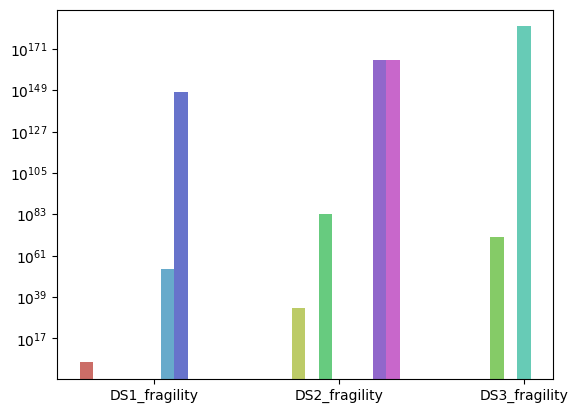

In [44]:
# plotting graph
import seaborn as sns
ax = sns.barplot(data=building_intensity_freq_compact , 
            x="probable_damage_what", 
            y='probable_damage', 
            hue='archtype',
            palette = "hls",
            errorbar=None,
            log=True)
ax.legend(title='Damage Fragility Probability (most likely)', bbox_to_anchor=(1, 1), loc='upper left')
ax.grid(axis='x')

<font color='white'>********************************************************************************************************************************************************************</font>

# 8) Visualise the impact

Let's now visualise the fragility impact state on for each building in Hull. 

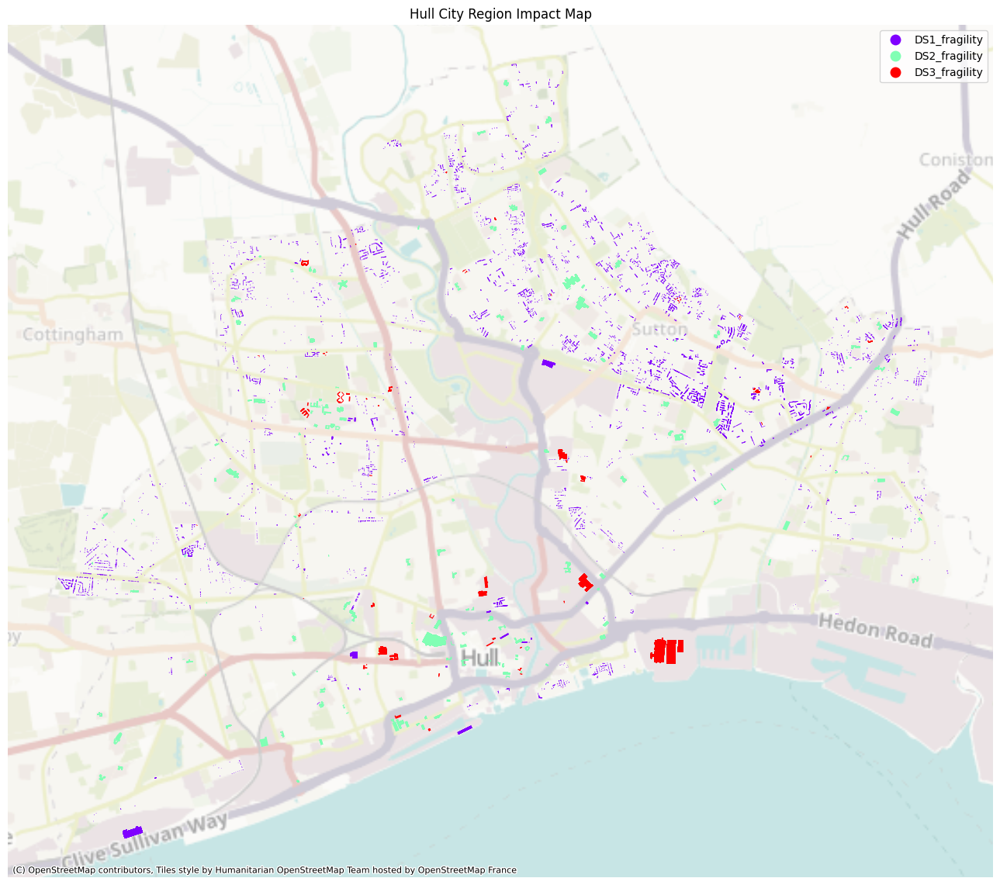

In [45]:
# Let's plot the intensity by damage states
fig, ax = plt.subplots(figsize=(13, 13))

# Plot
ax = building_intensity.to_crs(epsg=3857).plot(ax=ax, column="probable_damage", 
                                               legend=True, cmap="rainbow")

# Add a basemap
cx.add_basemap(ax, alpha=0.5)

# Show the plot
plt.axis("off")
fig.tight_layout()
plt.title("Hull City Region Impact Map")
plt.show()

## GeoDN Impact Module 

Please note that the above workflow is also available as a GeoDN Module. So instead of running through this Notebook, you will be able to find this Impact Module in the GeoDN Catalogue and run this for any given bounding box and flood data. How to look at the catalogue and how to run GeoDN modules is explained in the next section. 

# What's next? 

In the next course, you can see and learn how to create a GeoDN workflow and automate many of these manual steps. 

## And this concludes course 2 :) 